<h1 style="font-family: Didot; text-align: center;"> Problem 2 &mdash; Pijak</h1>

In [1]:
# needed imports
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import pandas as pd
from scipy.stats import norm, expon, poisson, lognorm


# set seaborn style
sns.set_style('darkgrid')

<h2 style="font-family: Didot;">Wprowadzenie</h2>

---


<span style="font-family: Didot; font-size: large;">
    
Naszym zadaniem będzie zbadanie szans na przeżycie pijaka wracającego do domu. Szanse te będziemy badać w zależności od wartości kilku parametrów:
    
- szybkości poruszania się pijaka w kierunku domu;
- szybkości samochodów;
- częstotliwości pojawiania się samochodów &mdash; zależnej od rozkładu mieszanego procesu Poissona;
- szerokości ulicy, po której poruszają się samochody.

<h3 style="font-family: Didot; font-size: large;"> Symulacja ruchu pijaka </h3>
<hr>
<span style="font-family: Didot; font-size: large;">
Zakładamy, że pijak porusza się po trajektorii ruchu Browna z dodanym w osi OX dryfem $v$ &mdash; możemy wyrazić ją jako $X_t = B_t + (vt, 0)$, gdzie $B_t$ to dwuwymiarowy ruch Browna.
    
Za krok czasowy $dt$ przyjmujemy równy $1$ &mdash; z racji złożoności obliczeniowej symulacji. Jest to dość duży krok, który trochę zakłamuje to jak ruch pijaka wyglądałby przy powyższych założeniach (o tym za chwilę poniżej).

Pijaka należy też odpowiednio odbijać od krawędzi obszaru. W przypadku wykroczenia pijaka poza wybraną oś (poziomą lub pionową) nowa pozycja będzie znajdować się w punkcie będącym odbiciem symetrycznym względem danej osi.
    
Poniżej klasa `Drinker`, w której zaimplementowaliśmy pijaka zgodnie z powyższymi wskazaniami.

In [2]:
class Drinker:
    """Class implementation of a drinker."""
    
    def __init__(self, v):
        """Initialize class object attributes."""
        self.x = 0
        self.y = 0
        self.v = v
        self.trajectory = [(0, 0)]
        
    def move(self):
        """Move the drinker to another position according to chosen mode."""
        self.x += np.random.randn() + self.v 
        self.y += np.random.randn()
        self.x = abs(self.x)
        self.y = abs(self.y)
        if self.y > 50:
            self.y = 100 - self.y 
        self.trajectory.append((self.x, self.y))

<span style="font-family: Didot; font-size: large;">
    
Zbadamy teraz jak wygląda ruch pijaka w zależności od jego prędkości. Stworzymy wykresy kilkudziesięciu trajektorii ruchu. Dla każdej trajektorii przygotujemy histogram &mdash; będziemy badać jak często pijak znajduje się na danej wysokości w osi OY. Następnie wszystkie histogramy naniesiemy na jeden wykres. Jest to wykres pozwalający jedynie na podstawowe obserwacje, niekoniecznie praktyczny, ale umieszczamy go ze względu na to, że bardzo się nam spodobał.
    
Dla klarowności przygotujemy mapy ciepła zagęszczenia ruchu pijaka.  
    
Pomocne w tym będą funkcje `visualize` i `density_heatmap`. 

In [3]:
def visualize(n, v_d):
    ys = []
    fig, ax = plt.subplots(1, 2, figsize=(15, 6))
    for i in range(n):
        drinker = Drinker(v_d)
        while drinker.x < 1000:
            drinker.move()
        y = [i[1] for i in drinker.trajectory]
        ax[0].plot([i[0] for i in drinker.trajectory], y)
        ys.append(y)
    ax[0].set_title(f"{n} trajektorii pijaka dla v = {v_d}")
    sns.histplot(ys, ax=ax[1], legend=False, alpha=0.5)
    ax[1].set_title(f"Zageszczenie ruchu pijaka dla v = {v_d}")
    plt.show()

    
def density_heatmap(n, v_d):
    X = []
    Y = []
    for i in range(n):
        drinker = Drinker(v_d)
        while drinker.x < 1000:
            drinker.move()
            X.append(drinker.x)
            Y.append(drinker.y)
    df = pd.DataFrame({'x':X, 'y':Y})
    fig = px.density_heatmap(df, x='x', y='y', title=f"Mapa ciepła ruchu pijaka dla v = {v_d}")
    fig.show()

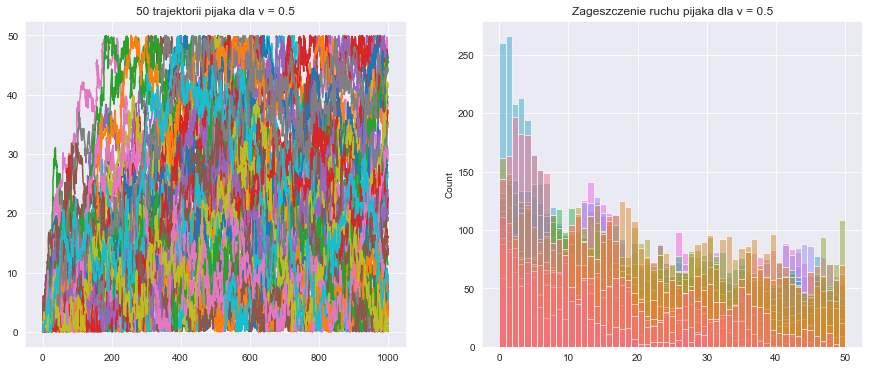

In [4]:
visualize(50, 0.5)

In [5]:
density_heatmap(50, 0.5)

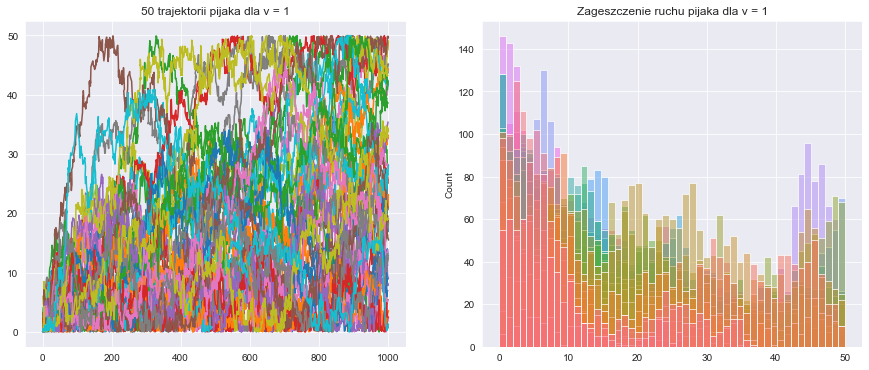

In [6]:
visualize(50, 1)

In [7]:
density_heatmap(50, 1)

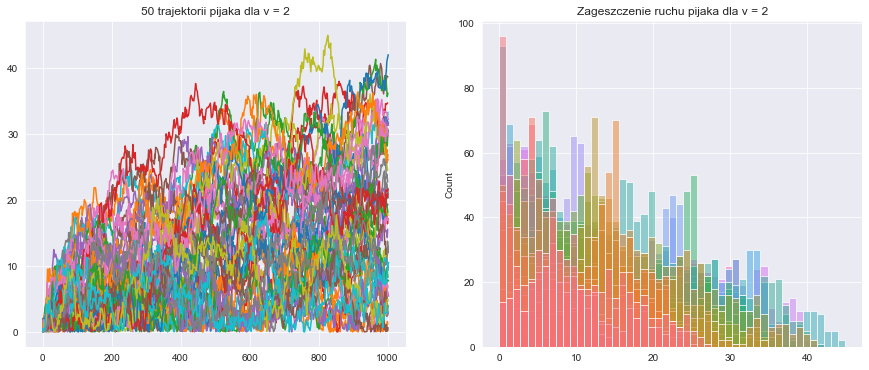

In [8]:
visualize(50, 2)

In [9]:
density_heatmap(50, 2)

<span style="font-family: Didot; font-size: large;">

Możemy zauważyć, wraz ze wzrostem szybkości pijak znacznie rzadziej znajduję się w górnej połowie rozpatrywanego obszaru. Już w tym miejscu można więc przepuszczać, że wzrost prędkości pomaga pijakowi w przeżyciu, ponieważ rzadziej zapuszcza się wtedy na drogę.
    
Wcześniej zadaliśmy sobie pytanie, jak wyglądałyby ruch pijaka dla znacznie mniejszego $dt$. Weźmy $dt = 0.01$ i postąpmy analogicznie jak powyżej. 

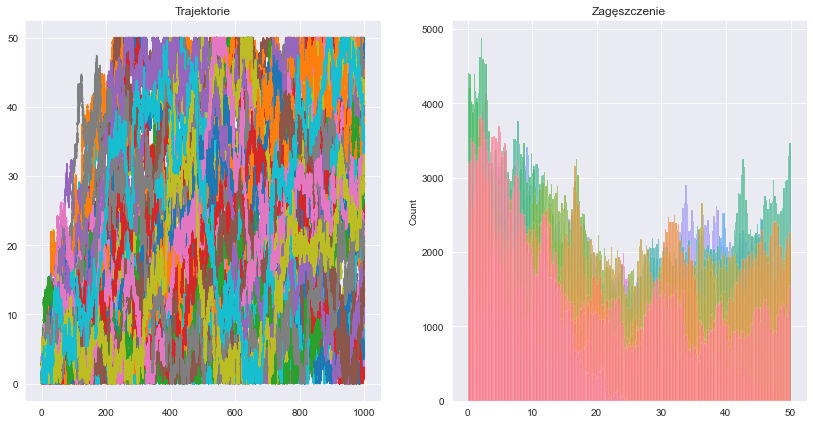

In [145]:
fig, ax = plt.subplots(1, 2, figsize=(14, 7))
ys = []
for i in range(50):
    x, y = (0, 0)
    dt = 0.01
    trajx = [x]
    trajy = [y]
    while x < 1000:
        x += np.sqrt(dt) * np.random.randn() + 0.5 * dt
        y += np.sqrt(dt) * np.random.randn()
        x = abs(x)
        y = abs(y)
        if y > 50:
            y = 100 - y
        trajx.append(x)
        trajy.append(y)
    ys.append(trajy)
    ax[0].plot(trajx, trajy)
ax[0].set_title("Trajektorie")
ax[1].set_title("Zagęszczenie")
sns.histplot(ys, ax=ax[1], legend=False)
plt.show()

<span style="font-family:Didot; font-size:large;">
Możemy zauważyć, że po zmniejszeniu kroku, uzyskaliśmy znacznie inny rezultat. Pijak, mimo że jego prędkość wynosiła $2\frac{\text{m}}{\text{s}}$, znacznie częściej poruszał się w górnej części obszaru. 
    
Widzimy więc, że w pewnym sensie pomogliśmy pijakowi. Dzięki większemu krokowi czasowemu, zwiększyliśmy jego szanse na przeżycie &mdash; będzie bowiem rzadziej przecinać drogę.

<h3 style="font-family:Didot;">Implementacja samochodów i momentów ich pojawiania się</h3>
<hr>

<span style="font-family: Didot; font-size: large;">    

Samo poruszanie się samochodów nie trudno zaimplementować &mdash; w zależności od miejsca pojawienia się (kierunku jazdy &mdash; `direction`) będziemy samochód przesuwać od $v\cdot dt$, gdzie $v$ to prędkość samochodu.

In [45]:
class Car:
    """Class implementing a car."""

    def __init__(self, x, y, v, direction):
        """Initialize the class object attributes."""
        self.x = x
        self.y = y
        self.v = v
        self.direction = direction
    
    def move(self):
        """Move car to a new position."""
        self.x += self.direction * self.v 
        
    def get_vel(self):
        """Return car's velocity."""
        return self.v

<span style="font-family: Didot; font-size: large;">
Większe wyzwanie stanowi odpowiednie zaimplementowanie momentów pojawienia się samochodów z racji tego, że posługujemy się "bardzo" dyskretnym czasem. 
    
Zgodnie z poleceniem, czasy pojawienia się samochodów to momenty skoków mieszanego procesu Poissona. Żeby je "zdyskretyzować" najpierw przeskalujemy je przez dodatni skalar `scale` $ > 0$, zaogrąglimy do jedności, a następnie zwrócimy te czasy, które mieszczą się w zadanym horyzoncie czasowym $T$ (ilość kroków jaką w danej symualcji potrzebował pijak, by dostać się do domu).
    
Domyślnie, `scale` $= 10$.

In [47]:
def mixed_poisson(Λ, T):
    """
    Return an array with moments of mixed Poisson process jumps moments.
    :param Λ: a probabilistic distribution
    :param T: time horizon
    """
    S = []
    λ = abs(Λ.rvs())
    U = np.random.rand()
    t = - 1 / λ * np.log(U)
    while t < T:
        S.append(t)
        U = np.random.rand()
        t = t - 1 / λ * np.log(U)
    return np.array(S)



def generate_arrivals(Λ, T, scale=10):
    """
    Return rounded and scaled mixed Poisson jumps moments.
    :param Λ: probabilistic distribution
    :param T: time horizon
    :param scale: scalar scaling the moments of jumps
    """
    arr = np.round(scale * mixed_poisson(Λ, T))
    return arr[arr < T]

<span style="font-family:Didot;font-size:large;">
    
W powyższych funkcjach pojawia się metoda `rvs`. Żeby móc wywołać ją dla rozkłądu jednostajnego (z którego będziemy często korzystać w trakcie symulacji) stworzyliśmy odpowiednią klasę `Unif`. 

In [46]:
class Unif:
    """Class implementation of a uniform distribution."""
    
    def __init__(self, a, b):
        """Initialize the class object's attributes."""
        self.a = a
        self.b = b
        
    def rvs(self):
        """Return a number from uniform U(a, b) distribution."""
        return np.random.uniform(self.a, self.b)

<h2 style="font-family: Didot;">Analiza wpływu parametrów na szanse pijaka</h2>
<hr>

<span style="font-family:Didot;font-size:large;">

Poniższa funkcja `simulation` przeprowadza pojedynczą symulacje "spaceru" pijaka. Najpierw wyznaczamy horyzont czasowy $T$, dla niego momenty pojawienia się samochodów, a następnie w każdym kroku symulacji sprawdzamy czy wystąpiła kolizja.

Funkcja zwraca wartość logiczną **True** lub **False** w zależności od tego czy pijakowi udało się dotrzeć do domu. W przypadku zwrócenia wartości **False**, zwracamy także moment uderzenia &mdash; śmierci &mdash; pijaka.
    
    
Funkcja `analysis` służy do powtórzenia przeprowadzenia symulacji Monte Carlo ($n$ powtórzeń).

In [48]:
def simulation(d, v_d, v_m, v_M, dist1, dist2):
    """
    Return True if drinker managed to reach home, False and moment of death otherwise.
    :param d: width of the road
    :param v_d: velocity of drinker
    :param v_m: minimal cars' velocity
    :param v_M: maximal cars' velocity
    :param dist1: probabilistic distribution used for generating moments of 'left cars' arrivals
    :param dist2: probabilistic distribution used for generating moments of 'right cars' arrivals
    """
    drinker = Drinker(v_d)
    while drinker.x < 1000:
        drinker.move()
    T = len(drinker.trajectory)
    left_arrivals = generate_arrivals(dist1, T, 10)
    right_arrivals = generate_arrivals(dist2, T, 10)
    cars_left = []
    cars_right = []
    for i in range(T):
        if cars_left:
            v_left_max = min([k.get_vel() for k in cars_left])
        else:
            v_left_max = v_M
        if cars_right:
            v_right_max = min([k.get_vel() for k in cars_right])
        else:
             v_right_max = v_M   
        if i in left_arrivals:
            cars_left.append(Car(0, 25 + d/2, np.random.uniform(v_m, v_left_max), 1))
        if i in right_arrivals:
            cars_right.append(Car(1000, 25 - d/2, np.random.uniform(v_m, v_right_max), -1))
        drinker_x, drinker_y = drinker.trajectory[i]
        for k in cars_left:
            if k.x - 10 < drinker_x < k.x and k.y - 2.5 < drinker_y < k.y + 2.5:
                return False, i
        for k in cars_right:
            if k.x + 10 > drinker_x > k.x and k.y - 2.5 < drinker_y < k.y + 2.5:
                return False, i
        for k in [*cars_left, *cars_right]:
            k.move()
        cars_left = [k for k in cars_left if k.x < 1010]
        cars_right = [k for k in cars_right if k.x > -10]
    return True, 


def analysis(n, d, v_d, v_m, v_M, dist1, dist2):
    """Return the average results of n repeats of simulation function."""
    data = [simulation(d, v_d, v_m, v_M, dist1, dist2) for i in range(n)]
    prob = sum([i[0] for i in data]) / n
    moments_of_hits = [i[1] for i in data if i[0] == False]
    return prob, moments_of_hits

<span style="font-family: Didot; font-size:large;">
Ustalmy pewne domyślne parametry dla naszych symulacji:
    
    
- $n = 1000$ &mdash; ilość powtórzeń symulacji,
- $d =10$ &mdash; szerokość ulicy,
- $v_d = 2$ &mdash; szybkość pijaka,
- $v_m = 10$ &mdash; minimalna szybkość samochodów,
- $v_M = 15$ &mdash; maksymalna szybkość samochodów,
- $\mathcal{U}(0.15, 0.3)$ &mdash; rozkład mieszanego rozkładu Poissona (zarówno dla samochodów jadących z lewej, jak i z prawej strony).

In [49]:
# default parameters 
n = 1000
d = 10
v_d = 2
v_m = 10
v_M = 15
dist1 = Unif(0.15, 0.3)
dist2 = Unif(0.15, 0.3)

<span style="font-family: Didot; font-size:large;">
    
Stworzymy też funkcje, którą zautomatyzują wizualizacje wyznaczonych danych &mdash; `probability_plot` i `moments_of_hits`. Z ich wykorzystaniem przedstawimy zależności prawdopodobieństwa przeżycia pijaka w zależności od zmieniających się wartości jednego z parametrów, ale i także wykresy pudełkowe momentów śmierci pijaka.

In [50]:
def probability_plot(vec, data, title, xlabel, ylabel):
    fig, ax = plt.subplots(figsize=(12, 6))
    sns.lineplot(x=vec, y=data)
    sns.scatterplot(x=vec, y=data)
    plt.title(f"Prawdopodobieństwo przeżycia pijaka w zależności od {title}", fontsize=20)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.show()
    
def moments_of_hits(vec, df, xlabel, ylabel):
    fig, ax = plt.subplots(figsize=(12, 6))
    sns.boxplot(data=df.transpose())
    plt.xticks(list(range(len(vec))), [f"{round(i, 2)}" for i in vec])
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title("Momenty śmierci na boxplotach", fontsize=20)
    plt.show()

<h3 style="font-family: Didot;"> Wpływ szybkości pijaka na szanse przeżycia </h3>
<hr>

<span style="font-family: Didot; font-size:large;"> 
    
Wyznaczymy prawdopodobieństwa dla $15$ różnych prędkości z zakresu $(0.5, \, 2)\frac{\text{m}}{\text{s}}$.

In [51]:
vs = np.linspace(0.5, 2, 15)
probs_v = []
hits_v = []
for i in vs:
    data = analysis(n, d, i, v_m, v_M, dist1, dist2)
    probs_v.append(data[0])
    hits_v.append(data[1])
df1 = pd.DataFrame(hits_v)

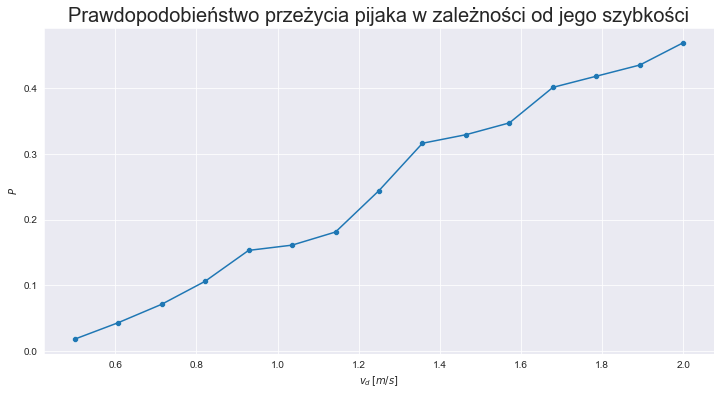

In [53]:
probability_plot(vs, probs_v, "jego szybkości", r"$v_d\, [m / s]$", "$P$")

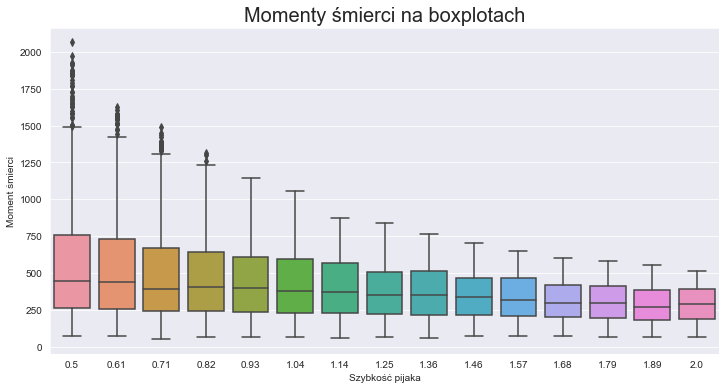

In [85]:
moments_of_hits(vs, df1, "Szybkość pijaka", "Moment śmierci")

<span style="font-family:Didot;font-size:large;">
Można zauważyć, że wzrost prędkości pijaka zapewnia mu większe szanse na przeżycie. Co warto zauważyć dla małych prędkości pijak zdecydowanie częściej ginie (prawdopodobieńtwo przeżycia bliskie zeru).
    
Przyglądając się drugiemu wykresowi możemy stwierdzić, że boxploty stają się coraz węższe, co spowodowane jest tym, że pijak potrzebuje mniej czasu na dotarcie do końca planszy (ginąć też będzie szybciej). Dla mniejszych prędkości jest więcej obserwacji odstających.

<h3 style="font-family: Didot;"> Wpływ szerokości ulicy na szanse przeżycia </h3>
<hr>
<span style="font-family:Diodot;font-size:large;">
Terz też postępujemy podobnie &mdash; wyznaczamy prawdopodobieństwa i momenty śmierci dla $15$ wartości szerokości drogi z zakresu $(5, 15)$.

In [64]:
ds = np.linspace(5, 15, 15)
probs_d = []
hits_d = []
for i in ds:
    data = analysis(n, i, v_d, v_m, v_M, dist1, dist2)
    probs_d.append(data[0])
    hits_d.append(data[1])
df2 = pd.DataFrame(hits_d)

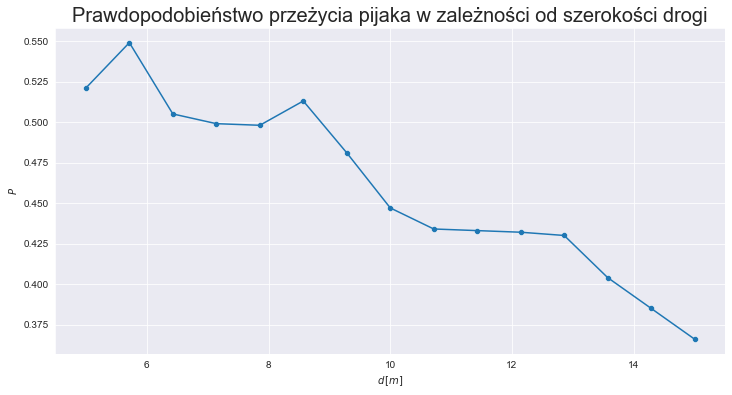

In [148]:
probability_plot(ds, probs_d, "szerokości drogi", r"$d\, [m]$", "$P$")

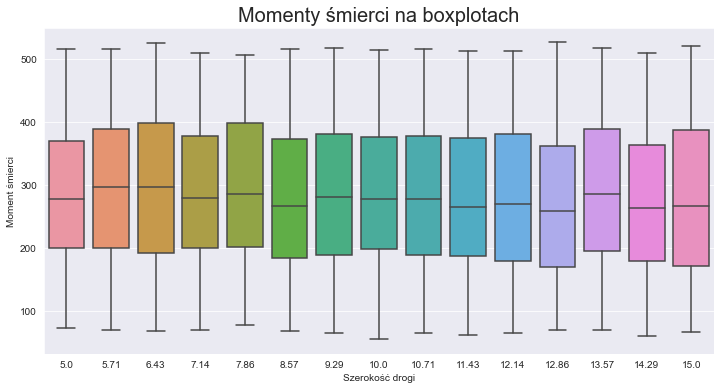

In [87]:
moments_of_hits(ds, df2, "Szerokość drogi", "Moment śmierci")

<span style="font-family: Didot; font-size:large;">
Wniosek z wykresów jest dość prosty: szersza ulica &mdash; nie masz życia.
    
Boxploty tym razem nie róźnią się tak bardzo. Możemy zauważyć, że zarówno ich wąsy, jak i linie wyrażające medianę, znajdują się na podobnym poziomie. Szerokość ulicy nie wpływa  więc aż tak mocno na moment śmierci, jedynie na prawdopodobieństwo jej zajścia.

<h3 style="font-family: Didot;"> Wpływ prędkości poruszania się samochodów na szanse przeżycia </h3>
<hr>
<span style="font-family:Didot; font-size:large;">

Wpływ prędkości samochodów będziemy badać poprzez pozwolenie samochodom na przyjmowanie wartości z przedziału $(v, v+5)$. Będziemy więc wariować dolną granicą &mdash; będzie przyjować kolejne wybrane wartości z przedziału $(10, 40)$.

In [151]:
vs_cars = np.linspace(10, 40, 20)
probs_vs_cars = []
hits_vs_cars = []
for i in vs_cars:
    data = analysis(n, d, v_d, i, i+5, dist1, dist2)
    probs_vs_cars.append(data[0])
    hits_vs_cars.append(data[1])
df3 = pd.DataFrame(hits_vs_cars)

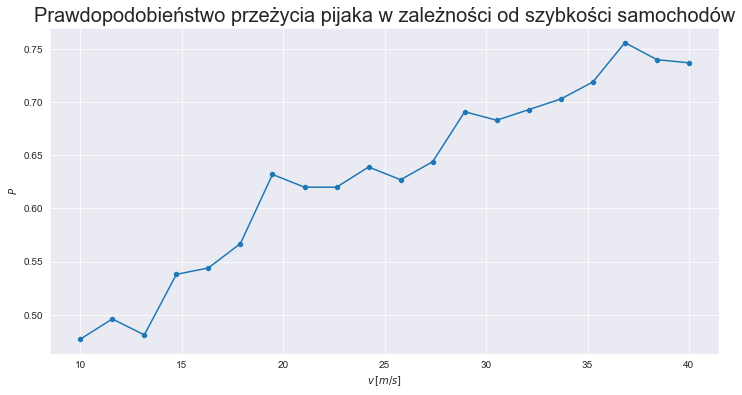

In [152]:
probability_plot(vs_cars, probs_vs_cars, "szybkości samochodów", "$v \,[m/s]$", "$P$")

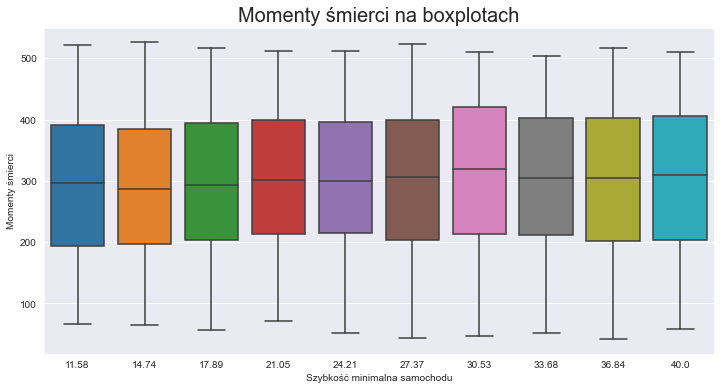

In [153]:
moments_of_hits(vs_cars[1::2], df3[df3.index % 2 == 0], "Szybkość minimalna samochodu", "Momenty śmierci")

<span style="font-family:Didot;font-size:large;">
Widzimy, że szanse pijaka wzrastają wraz ze wzrostem prędkości minimalnej samochodów. Dla dużych prędkości prawdopodobieństwo jest bardzo wysokie &mdash; przekracza nawet $0.75$. Boxploty podobnie jak wcześniej mają zarówno wąsy, jak i kwartyle rzędu $0.5$ na podobnym poziomie.
    
    
Nie będziemy rozpatrywać sytuacji, w której będziemy zwiększać prędkość samochodów jadących tylko z jednej strony, ponieważ wyniki będą analogiczne do tych, które teraz uzyskaliśmy. Możemy z pewnością stwierdzić, że jeżeli pijak woli bardziej poruszać się w dolnej części obszaru, to zwiększanie prędkości samochodów jadących z lewej strony będzie szybciej zwiększać szanse pijaka na przeżycie.

<h3 style="font-family: Didot;"> Wpływ rozkładów pojawiania się samochodów na szanse przeżycia </h3>
<hr>
<span style="font-family:Didot;font-size:large;">
Wpływ na ilość skoków mieszanego procesu Poissona ma jego intensywność. Wiemy, że dla mieszanego procesu Poissona $N(t)$, że:
    
$$ \mathbb{E}\left[N(t)\right] = t \,\mathbb{E}\left[\Lambda\right],$$
    
gdzie $\Lambda$ jest zmienną mieszającą. Ilość skoków nie zależy więc aż tak mocno od rozkładu jaki się dobierze, a
 od jego wartości oczekiwanej (oczywiście rozpatrujemy $\Lambda > 0$).   
    
Wpływ rozkładu będziemy badać dla rozkładu jednostajnego $\mathcal{U}(a, a+0.1)$ dla $a \in \left[0.1, 1\right]$.
Dla takiego rozkładu nieprzewidywalność częstotliwości pojawiania się samochodów stanie się bardziej przewidywalna &mdash; ze względu na waski przedziały.

In [154]:
freqs = np.linspace(0.1, 1, 15)
probs_freq = []
hits_freq = []
for i in freqs:
    data = analysis(n, d, v_d, v_m, v_M, Unif(i, i+0.1), Unif(i, i+0.1))
    probs_freq.append(data[0])
    hits_freq.append(data[1])
df4 = pd.DataFrame(hits_freq)

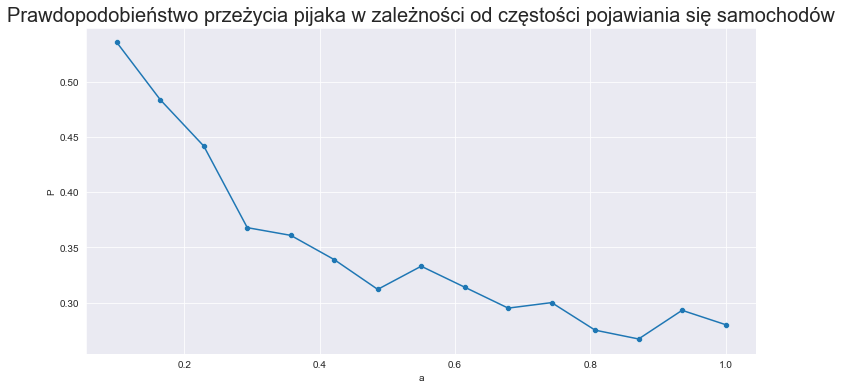

In [155]:
probability_plot(freqs, probs_freq, "częstości pojawiania się samochodów", "a", "P")

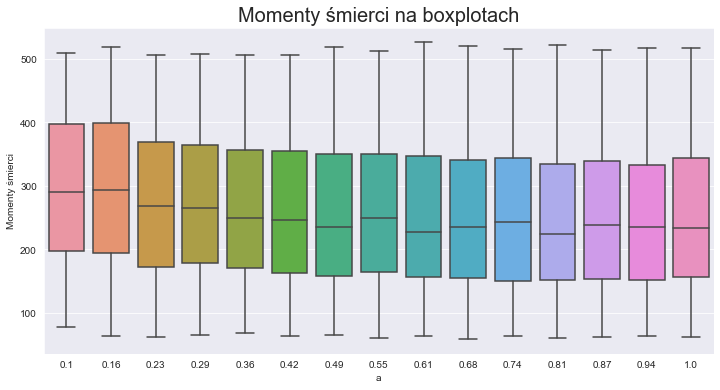

In [156]:
moments_of_hits(freqs, df4, "a", "Momenty śmierci")

<span style="font-family:Didot;font-size:large;">
Oczywiście wraz ze wzrostem wartości oczekiwanej zmiennej mieszającej, obserwujemy malejące szanse pijaka na powrót do domu. Prawdopodobieństwo dla dużej intensywności ruchu wynosi około $0.3$ (dość dużo)&mdash; wynika to stąd, że dla prędkości $v_d = 2$ pijak ma skłonność do nieprzekraczania połowy obszaru (czasami zdarza się, że nie dotyka nawet jezdni).
    
Na boxplotach możemy zaobserwować, że mediana momentu śmierci nieznacznie się obniża &mdash; średnio śmierć następuje więc coraz wcześniej.